In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import os
import matplotlib as plt
import scvelo as scv
import cellrank as cr
import loompy

In [2]:
sc.set_figure_params(facecolor="white", figsize=(15, 15))
sc.settings.verbosity = 3

In [3]:
my_path = os.getcwd()

In [4]:
adata_loom_NP3 = scv.read('NP3/NP3.loom', cache=True)
adata_loom_NP4 = scv.read('NP4/NP4.loom', cache=True)
adata_loom_NP3.var_names_make_unique()
adata_loom_NP4.var_names_make_unique()

... reading from cache file cache/NP3-NP3.h5ad
... reading from cache file cache/NP4-NP4.h5ad


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
filenames = ['./NP3', './NP4']
adatas = [sc.read_10x_mtx(filename, gex_only = False,cache=True) for filename in filenames]
adata = adatas[0].concatenate(adatas[1:], batch_key='gene_ids', batch_categories=filenames)

adata.var_names_make_unique()

adata_loom_NP3 = scv.read('NP3/NP3.loom', cache=True)
adata_loom_NP4 = scv.read('NP4/NP4.loom', cache=True)

... reading from cache file cache/NP3-matrix.h5ad
... reading from cache file cache/NP4-matrix.h5ad
... reading from cache file cache/NP3-NP3.h5ad
... reading from cache file cache/NP4-NP4.h5ad


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
output_path = my_path + '/combine_loom.loom'
loompy.combine([my_path + '/NP3/NP3.loom',my_path + '/NP4/NP4.loom'], key="Accession",output_file=output_path)

In [7]:
adata_loom = scv.read('combine_loom.loom', cache=True)
adata = scv.utils.merge(adata, adata_loom)

... reading from cache file cache/combine_loom.h5ad


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [8]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')
adata.var['ribo'] = adata.var_names.str.startswith(("RPS","RPL"))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)
adata.obs['log10GenesPerUMI'] =  np.log10(adata.obs.n_genes_by_counts) / np.log10(adata.obs.total_counts)
adata = adata[adata.obs.n_genes_by_counts < 9000, :]
adata = adata[adata.obs.pct_counts_mt < 20, :]
adata = adata[adata.obs.log10GenesPerUMI > 0.8, :]
adata = adata[adata.obs.total_counts > 500, :]
adata = adata[adata.obs.pct_counts_ribo > 5, :]
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata,min_mean=0.0125,max_mean=3,min_disp=0.5) # default value (may be to change)
adata.raw = adata
adata = adata[:, adata.var.highly_variable]
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata)
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
sc.tl.leiden(adata,resolution=0.1,key_added='leiden01')

/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


    finished (0:00:27)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden01', the cluster labels (adata.obs, categorical) (0:00:00)


In [9]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


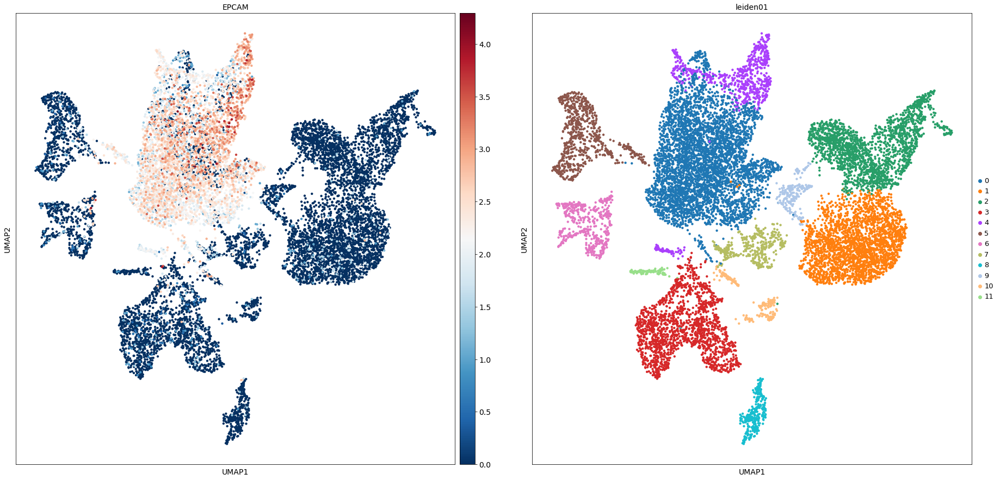

In [10]:
sc.pl.umap(adata,color=['EPCAM','leiden01'],color_map = 'RdBu_r',size=75)

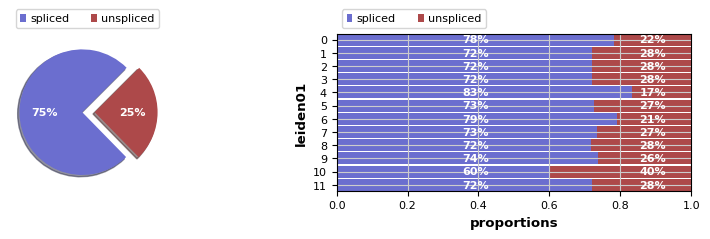

In [11]:
scv.pl.proportions(adata, groupby='leiden01')

In [12]:
adata_subset = adata[adata.obs['leiden01'].isin(['0','4'])]

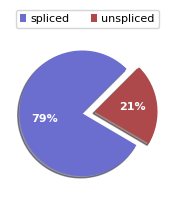

In [13]:
scv.pl.proportions(adata_subset)

In [61]:
df_genes = pd.read_csv('/home/rj/Desktop/analysis/visium/visium/signature_mak_1.csv',header=None)

list_gene = df_genes[0].tolist()

adata_gene_list =  list(adata.var['gene_ids'].keys())

gene_intersect = list(set(np.unique(np.unique(list_gene)
)) & set(adata_gene_list))

adata_subset = adata_subset[:, gene_intersect]

In [62]:
scv.pp.filter_and_normalize(adata_subset)

In [63]:
scv.pp.moments(adata_subset)

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [64]:
scv.tl.velocity(adata_subset)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [65]:
scv.tl.velocity_graph(adata_subset,n_jobs=8)

computing velocity graph (using 8/24 cores)


  0%|          | 0/5234 [00:00<?, ?cells/s]

/usr/local/lib/python3.8/dist-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [66]:
sc.tl.pca(adata_subset, svd_solver='arpack')
sc.pp.neighbors(adata_subset, n_neighbors=10, n_pcs=20)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [67]:
sc.tl.leiden(adata_subset,resolution=0.3,key_added='leiden03')

running Leiden clustering
    finished: found 6 clusters and added
    'leiden03', the cluster labels (adata.obs, categorical) (0:00:00)


In [68]:
sc.tl.umap(adata_subset)
sc.tl.tsne(adata_subset)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:10)


In [69]:
sc.set_figure_params(facecolor="white", figsize=(15, 15))

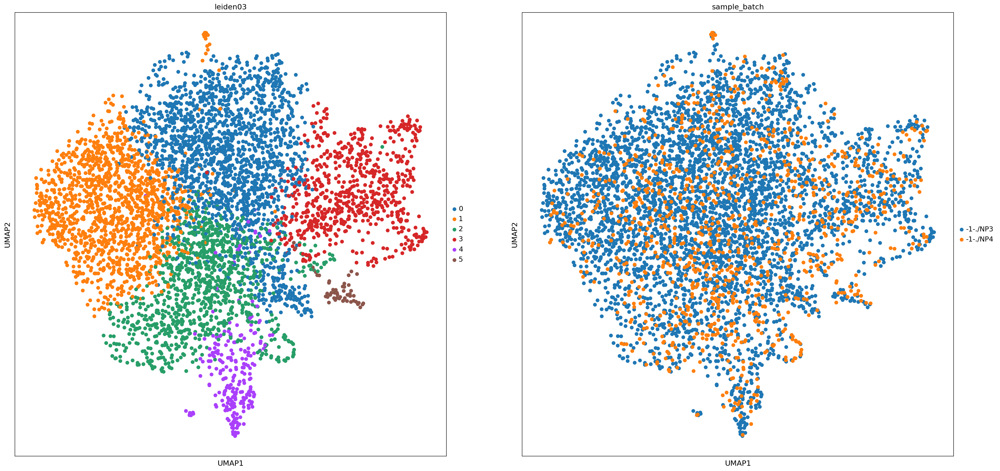

In [70]:
sc.pl.umap(adata_subset, color=['leiden03','sample_batch'],size=200,save='clustering.png')

In [71]:
scv.tl.velocity_graph(adata_subset)

computing velocity graph (using 1/24 cores)


  0%|          | 0/5234 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/usr/local/lib/python3.8/dist-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


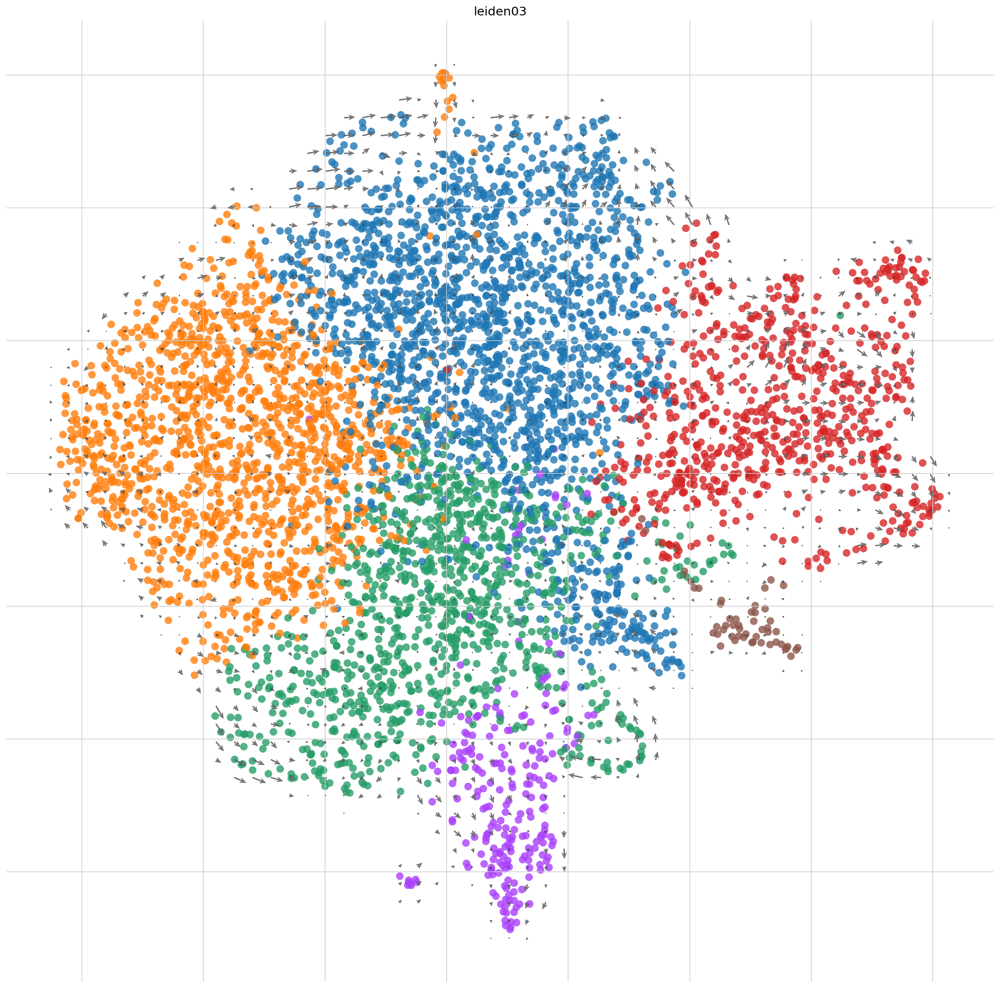

In [77]:
scv.pl.velocity_embedding_grid(adata_subset, basis='umap',color='leiden03',alpha=0.8,size=300)

saving figure to file ./figures/scvelo_umap_velocity_stream_embedding.png


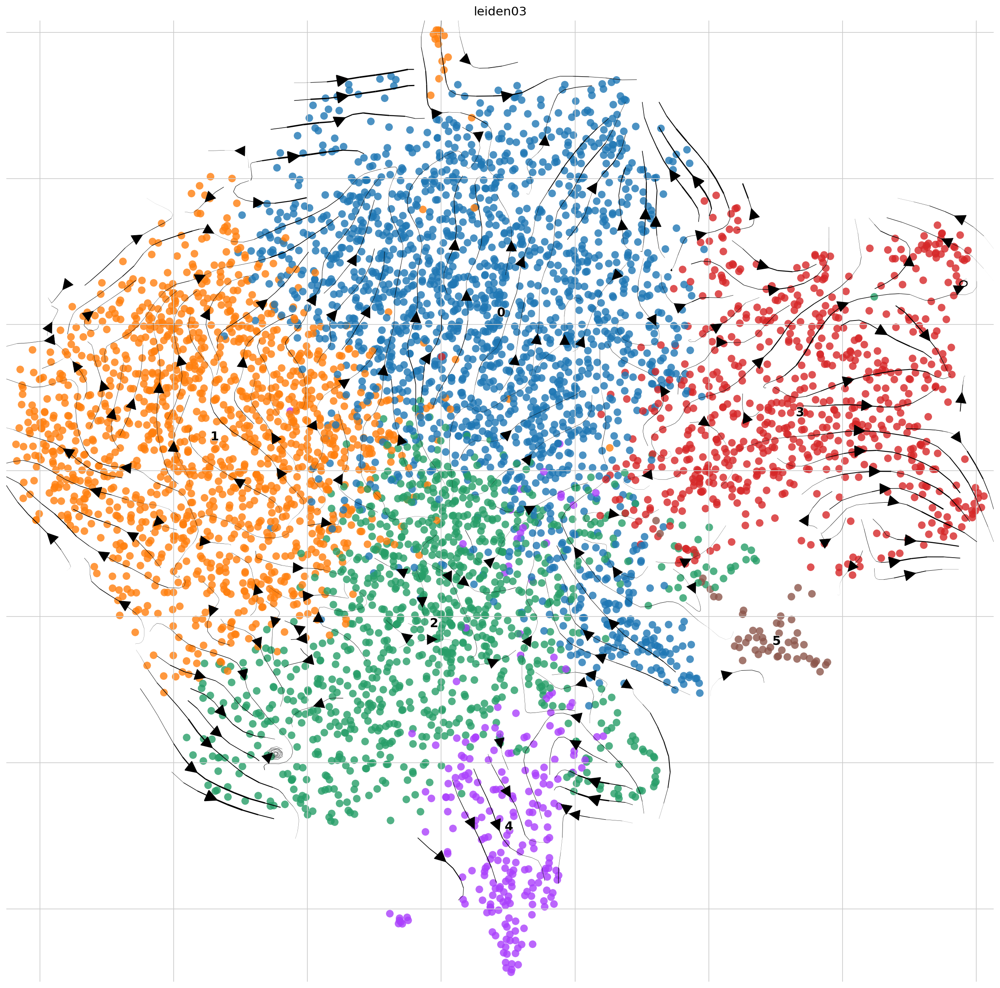

In [73]:
sc.set_figure_params(facecolor="white", figsize=(20, 20))
scv.pl.velocity_embedding_stream(adata_subset, basis='umap',color='leiden03',arrowsize=3,alpha=0.8,size=300,save='umap_velocity_stream_embedding.png')

saving figure to file ./figures/scvelo_COL.png


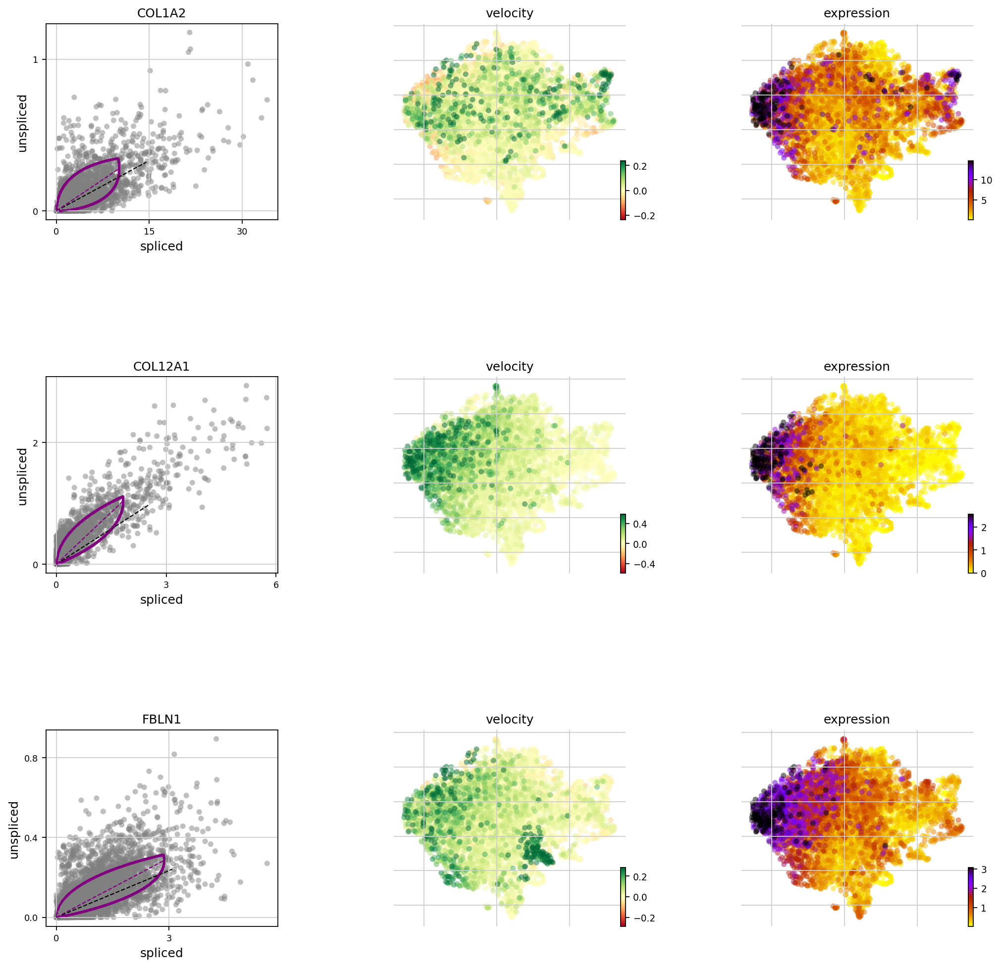

In [78]:
sc.set_figure_params(facecolor="white", figsize=(10, 10))
scv.pl.velocity(adata_subset, ['COL1A2','COL23A1','COL12A1','FBLN1'],size=100,save='COL.png')

saving figure to file ./figures/scvelo_WNT5A_CDH2_SHH_WNT6.png


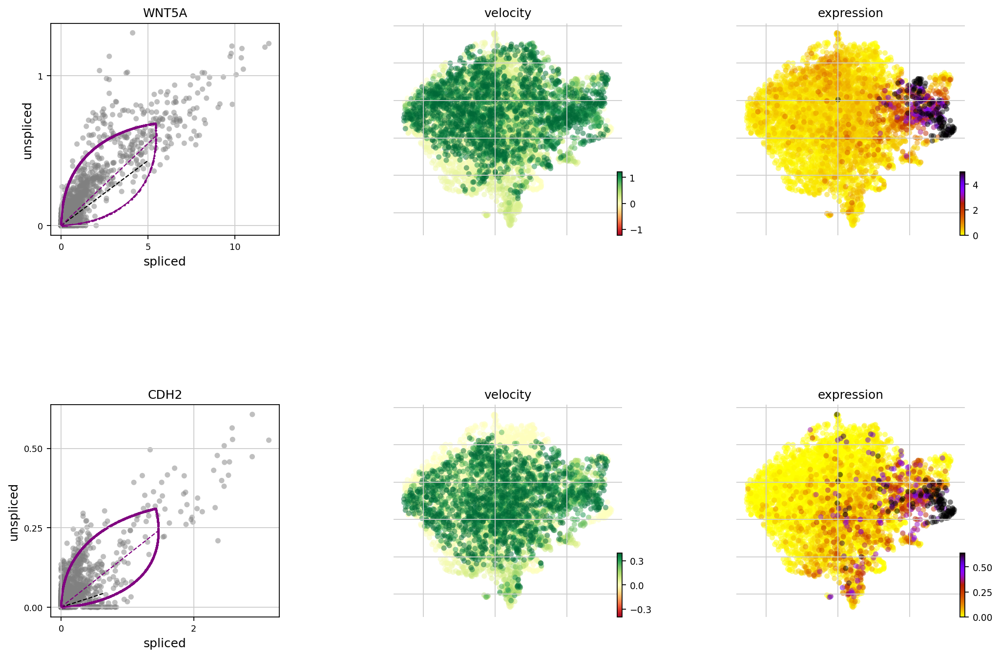

In [54]:
scv.pl.velocity(adata_subset, ['WNT5A','CDH2','SHH','WNT6','CD36','BMP7'],size=100,save='WNT5A_CDH2_SHH_WNT6.png')

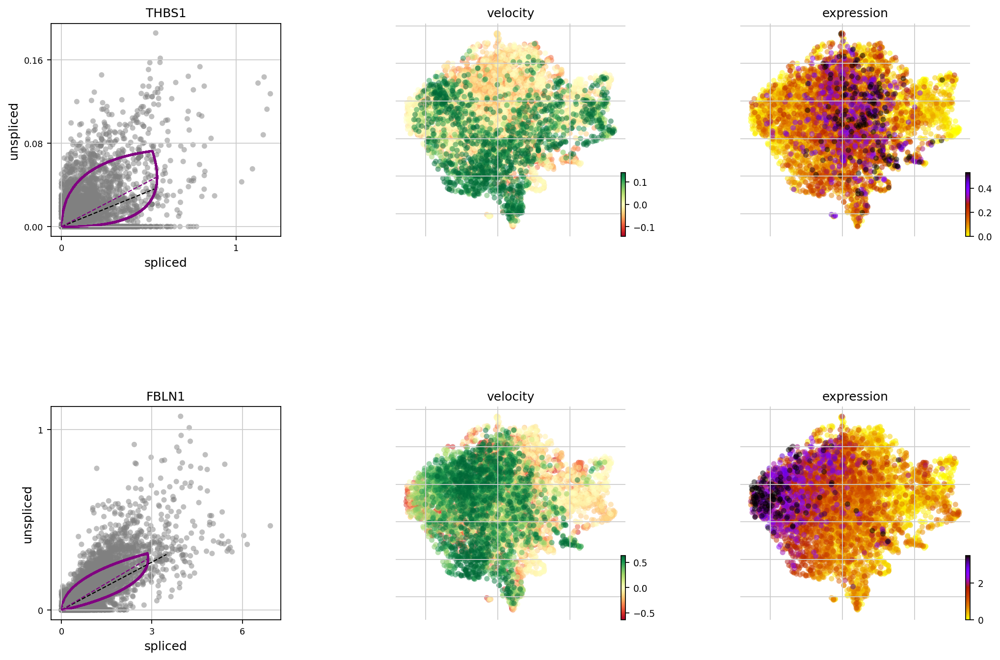

In [58]:
scv.pl.velocity(adata_subset, ['THBS1','FBLN1'],size=100)

In [34]:
scv.tl.rank_velocity_genes(adata_subset,groupby='leiden03',min_corr=0.3)

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [60]:
df  = scv.DataFrame(adata_subset.uns['rank_velocity_genes']['names'])
pd.set_option('display.max_rows', 500)
df.head(20)

,0,1,2,3,4,5
0,TNC,COL12A1,THBS1,LAMA3,SLIT3,FN1
1,ITGA2,FBLN1,MMP2,ANTXR1,FN1,SLIT3
2,DST,COL5A2,GEM,WNT5A,FSTL1,FSTL1
3,ENO2,TFPI2,PTHLH,CDH2,CDH2,ITGA2
4,GEM,PLOD2,FSTL1,FBN2,LAMA3,TNFRSF11B
5,AREG,CTHRC1,SERPINE1,SLIT3,TNC,QSOX1
6,VEGFA,GJA1,TFPI2,TNFRSF11B,THBS1,GEM
7,SPOCK1,CXCL8,GJA1,SERPINE1,MMP2,LAMA3
8,IGFBP3,PTHLH,TNC,NTM,CXCL8,DST
9,PTHLH,ANGPTL2,FN1,FN1,TFPI2,AREG


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)
saving figure to file ./figures/scvelo_confidence_plot.png


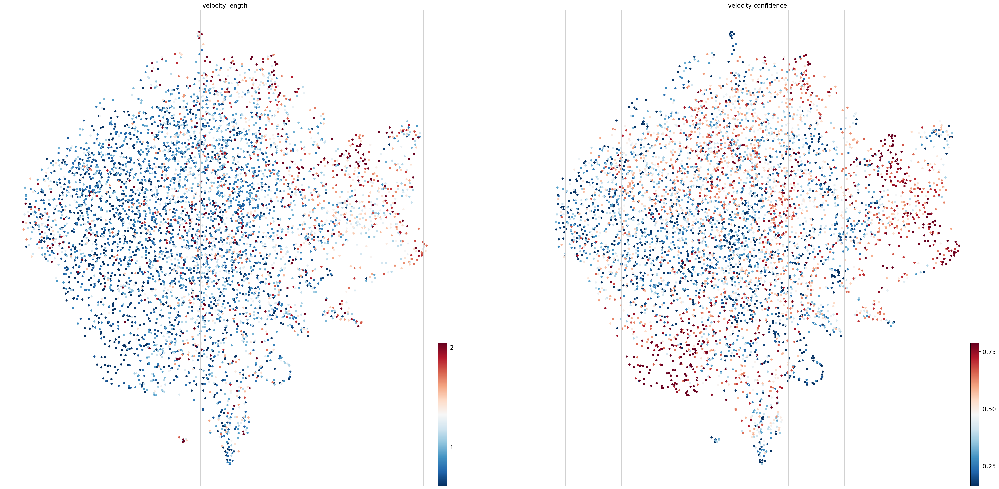

In [38]:
scv.tl.velocity_confidence(adata_subset)
keys = 'velocity_length','velocity_confidence'
scv.pl.scatter(adata_subset,c=keys,perc=[15,95],color_map = 'RdBu_r',size=100,save='confidence_plot.png')

computing terminal states
    identified 7 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


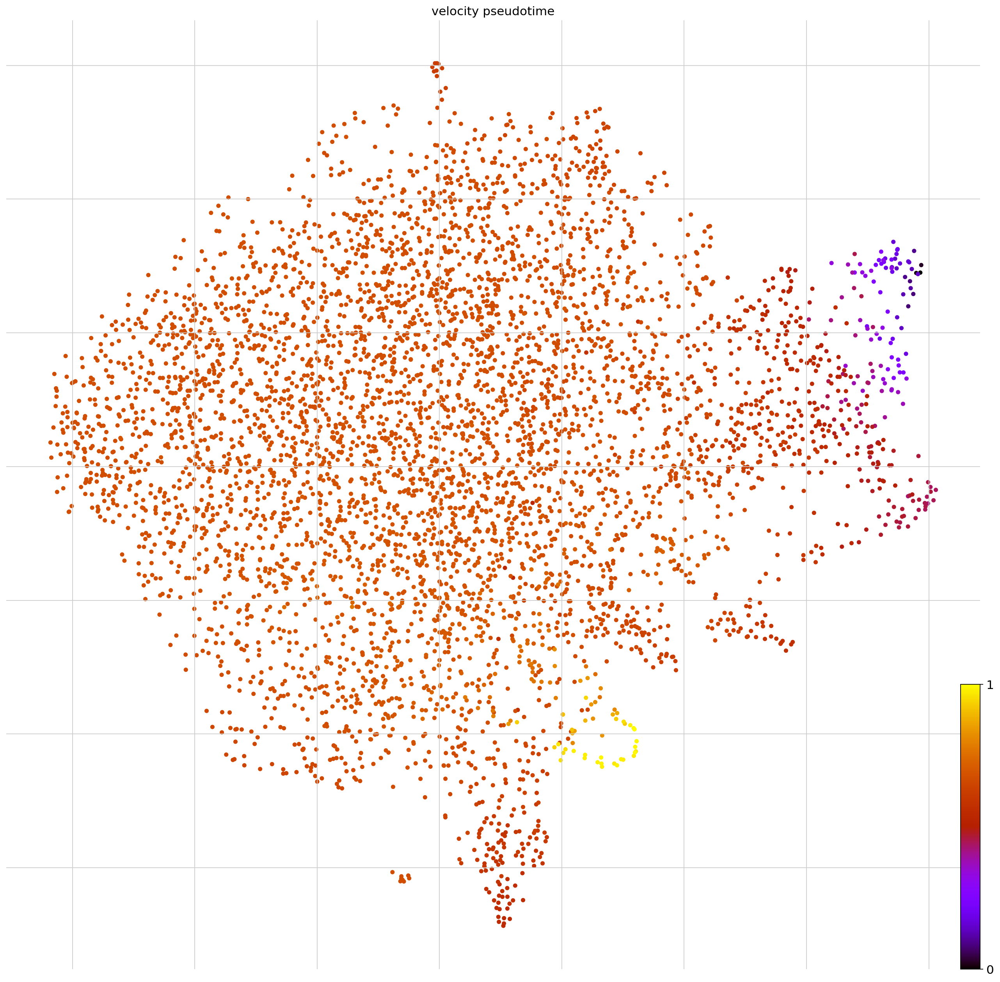

In [39]:
scv.tl.velocity_pseudotime(adata_subset)
scv.pl.scatter(adata_subset,color='velocity_pseudotime',color_map = 'gnuplot',size=100)

In [40]:
scv.tl.recover_dynamics(adata_subset,n_jobs=12)
scv.tl.velocity(adata_subset,mode='dynamical')
scv.tl.velocity_graph(adata_subset)

recovering dynamics (using 12/24 cores)


  0%|          | 0/58 [00:00<?, ?gene/s]

    finished (0:00:06) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/24 cores)


/usr/local/lib/python3.8/dist-packages/scvelo/tools/dynamical_model.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.alpha, dm.beta, dm.gamma, dm.pars[:3]]) / dm.m[-1]
/usr/local/lib/python3.8/dist-packages/scvelo/tools/dynamical_model.py:716: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.t, dm.tau, dm.t_, dm.pars[4]]) * dm.m[-1]


  0%|          | 0/5234 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/usr/local/lib/python3.8/dist-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_leiden03_stream_embedding.png


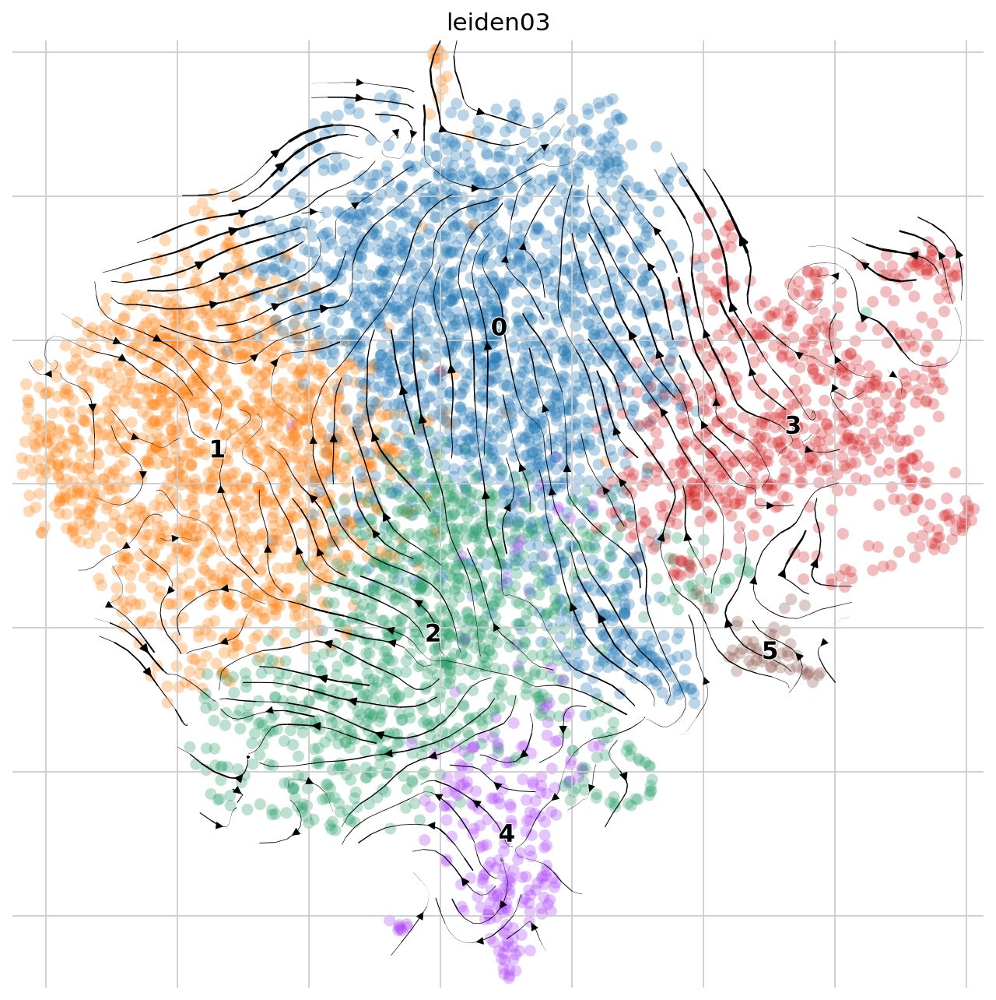

In [41]:
sc.set_figure_params(facecolor="white", figsize=(10, 10))
scv.pl.velocity_embedding_stream(adata_subset,basis='umap',color='leiden03',save='leiden03_stream_embedding.png')

computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)
saving figure to file ./figures/scvelo_latent_plot.png


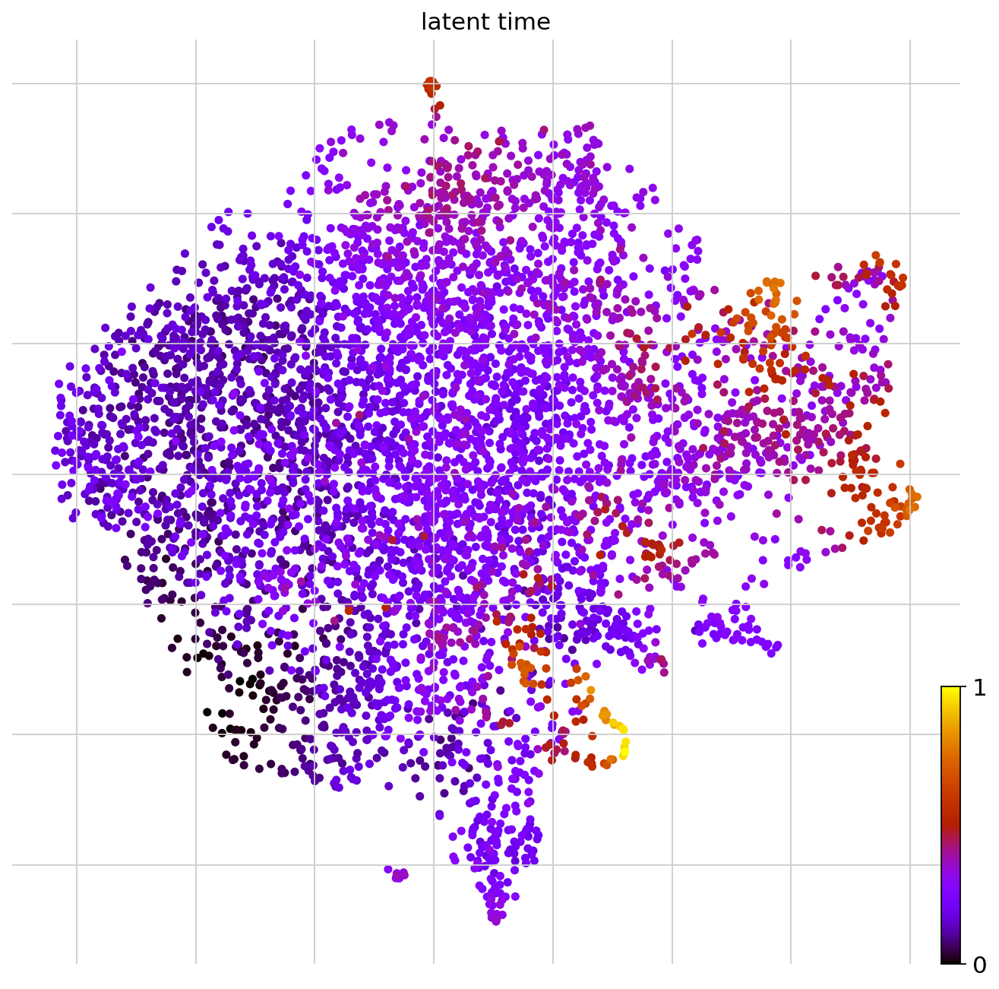

In [42]:
scv.tl.latent_time(adata_subset)
scv.pl.scatter(adata_subset,color= 'latent_time',color_map='gnuplot',size=100,save='latent_plot.png')

In [ ]:
df.head(10)

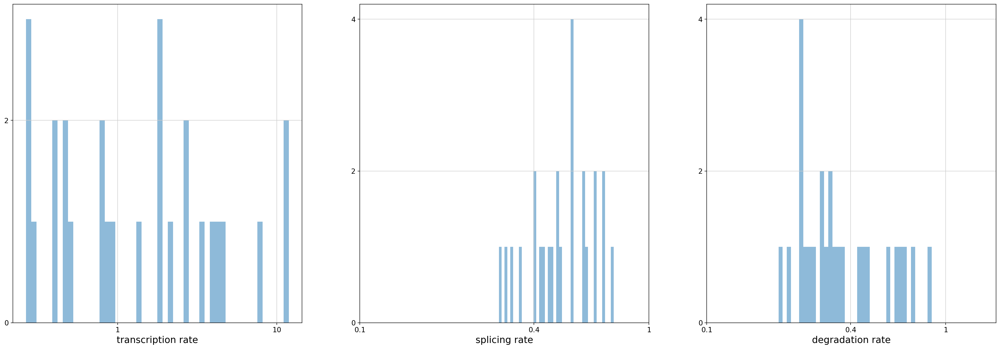

/usr/local/lib/python3.8/dist-packages/scvelo/core/_anndata.py:311: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  df.var_names = df.index


,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
DST,0.416015,0.788957,0.265680,13.285858,0.586561,0.175413,0.402975,2.038274e-01,0.0,0.0,0.472289,0.545188,1.194181,1.185617,2.911805,0.166760
NNMT,0.709518,11.441330,0.432837,5.082072,0.085233,0.017176,0.332504,4.509514e-07,0.0,0.0,0.470239,0.053713,1.027800,1.160216,1.691994,0.121834
GJA1,29.817624,76.655035,2.213792,7.667441,0.011113,0.094181,3.813627,2.754951e-01,0.0,0.0,0.497132,0.297745,9.384529,0.339793,0.528245,0.378635
TFPI2,11.900409,4.972352,0.586062,9.531237,0.061596,0.683599,5.243860,2.352328e-01,0.0,0.0,0.497670,2.213366,15.702988,0.914681,1.542723,0.713454
COL1A2,4.251973,11.858899,0.325835,7.055446,0.041104,0.096480,2.875310,1.598293e-01,0.0,0.0,0.497004,0.336486,10.177781,1.551411,2.393402,0.537768


In [43]:
df = adata_subset.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata_subset, 'fit*', dropna=True).head()

In [44]:
top_genes = adata_subset.var['fit_likelihood'].sort_values(ascending=False).index[:300]

saving figure to file ./figures/scvelo_heatmap_heatmap_top_latent_gene.png


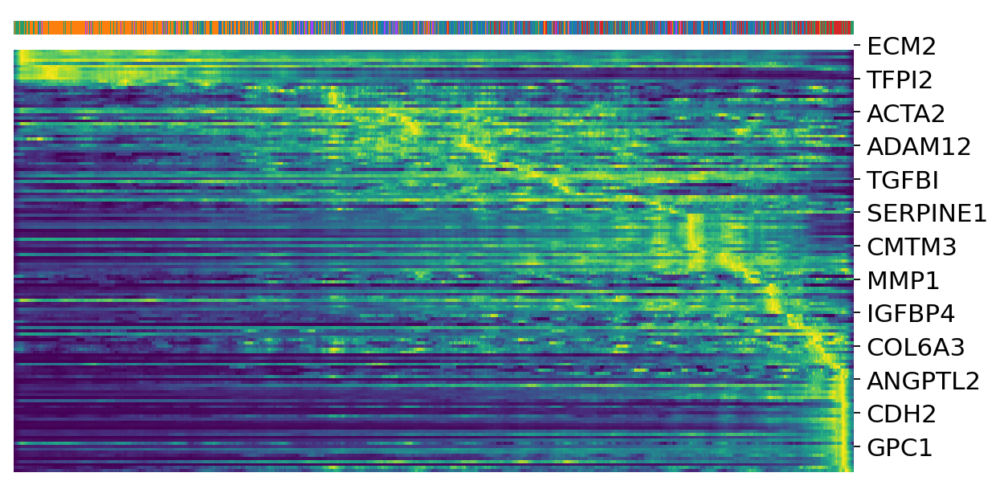

In [45]:
scv.pl.heatmap(adata_subset, var_names=top_genes, sortby='latent_time', col_color='leiden03', n_convolve=100,save='heatmap_top_latent_gene.png')

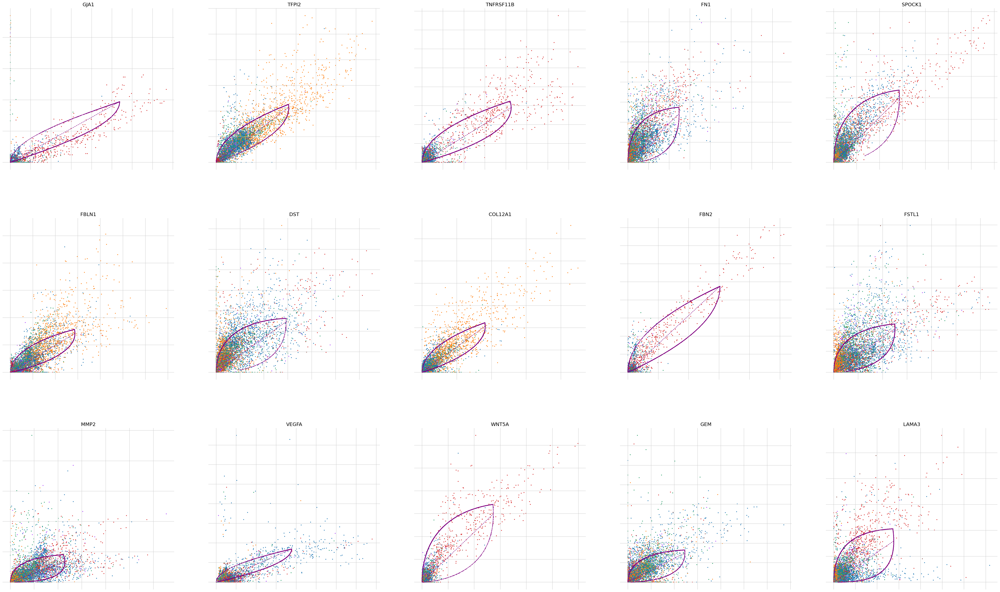

In [46]:
top_genes = adata_subset.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata_subset, basis=top_genes[:15], ncols=5, frameon=False,color='leiden03')

In [51]:
scv.tl.rank_dynamical_genes(adata_subset, groupby='leiden03')
df = scv.get_df(adata_subset, 'rank_dynamical_genes/names')
df.head(10)

ranking genes by cluster-specific likelihoods
    finished (0:00:00) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,0,1,2,3,4,5
0,SPOCK1,TFPI2,POSTN,GJA1,TFPI2,TNFRSF11B
1,DST,FBLN1,TFPI2,NTM,DST,THBS1
2,FBLN1,COL12A1,PDGFRB,ANTXR1,FSTL1,SPOCK1
3,ENO2,COL1A2,DST,FBN2,THBS1,MMP2
4,FSTL1,CXCL8,FN1,TNFRSF11B,GEM,DST
5,THBS1,COL5A2,THBS1,FN1,SLIT3,FN1
6,FN1,MCM7,CDH6,WNT5A,AREG,GEM
7,MMP2,GEM,FSTL1,MMP2,MCM7,FSTL1
8,GEM,QSOX1,SLIT3,CTHRC1,FN1,SLIT3
9,IGFBP3,DST,GEM,LAMA3,MMP2,COL5A2


In [48]:
adata_subset.uns['neighbors']['distances'] = adata_subset.obsp['distances']
adata_subset.uns['neighbors']['connectivities'] = adata_subset.obsp['connectivities']

scv.tl.paga(adata_subset, groups='leiden03')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


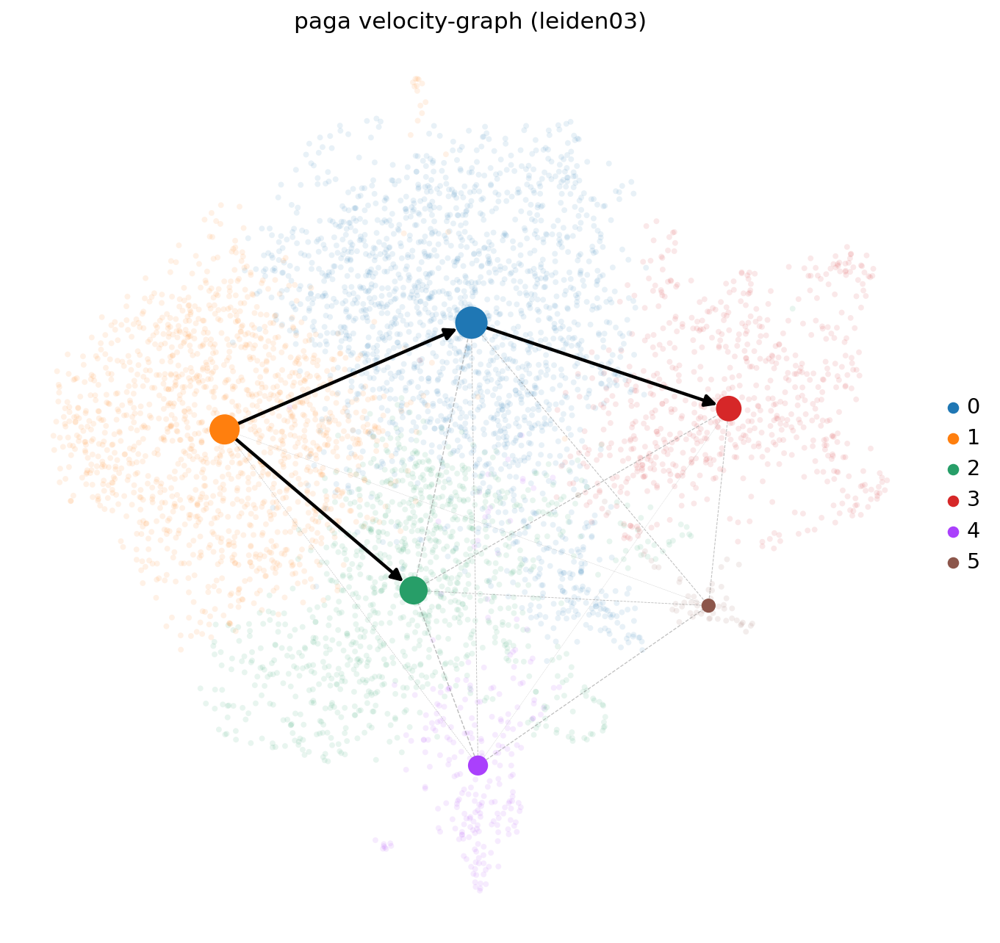

In [49]:
scv.pl.paga(adata_subset, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

In [50]:
df = adata_subset.obs.groupby('leiden03')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

leiden03,0,1,2,3,4,5
velocity_length,1.095464,0.882505,0.971175,1.397591,1.021213,1.418628
velocity_confidence,0.449792,0.329763,0.404806,0.524505,0.456509,0.515475


In [ ]:
adata_subset.raw = adata_subset
adata_subset.raw.to_adata().write('tumoral_test_withoutX.h5ad')